In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [2]:
import timm
import torch

def gen_yolo_timm_config(model_name='seresnet50', input_size=640):
    model = timm.create_model(model_name, features_only=True, pretrained=False)
    dummy_input = torch.randn(1, 3, input_size, input_size)
    outputs = model(dummy_input)

    print(f"# Backbone config for timm model: {model_name}")
    print(f"- [-1, 1, Timm, [{outputs[-1].shape[1]}, '{model_name}', False, True, 0, True]]  # - 0")

    index_blocks = []
    for i, out in enumerate(outputs):
        c, h, w = out.shape[1:]
        index_blocks.append((i, c, h, w))

    # Auto-select last 3 outputs for P3, P4, P5
    selected = index_blocks[-3:]

    for idx, (i, c, h, w) in enumerate(selected):
        print(f"- [0, 1, Index, [{c}, {i}]]   # selects {i}th output (1, {c}, {w}, {h}) - {idx+1}")

    # SPPF
    sppf_in_channels = selected[-1][1]
    sppf_out_channels = sppf_in_channels // 2  # often reduced
    print(f"- [-1, 1, SPPF, [{sppf_out_channels}, 5]] # SPPF - {len(selected)+1}")

    # C2PSA
    print(f"- [-1, 2, C2PSA, [{sppf_out_channels}]]   # C2PSA - {len(selected)+2}")

gen_yolo_timm_config('resnext50_32x4d', input_size=640)

# Backbone config for timm model: resnext50_32x4d
- [-1, 1, Timm, [2048, 'resnext50_32x4d', False, True, 0, True]]  # - 0
- [0, 1, Index, [512, 2]]   # selects 2th output (1, 512, 80, 80) - 1
- [0, 1, Index, [1024, 3]]   # selects 3th output (1, 1024, 40, 40) - 2
- [0, 1, Index, [2048, 4]]   # selects 4th output (1, 2048, 20, 20) - 3
- [-1, 1, SPPF, [1024, 5]] # SPPF - 4
- [-1, 2, C2PSA, [1024]]   # C2PSA - 5


In [3]:
!git clone https://github.com/VA0211/mri_timm.git

Cloning into 'mri_timm'...
remote: Enumerating objects: 907, done.
remote: Counting objects: 100% (907/907), done.
remote: Compressing objects: 100% (695/695), done.
remote: Total 907 (delta 232), reused 875 (delta 200), pack-reused 0 (from 0)
Receiving objects: 100% (907/907), 2.00 MiB | 12.04 MiB/s, done.
Resolving deltas: 100% (232/232), done.


In [4]:
# %pip install ultralytics
%cd /kaggle/working/mri_timm
%pip install -e .
import ultralytics
ultralytics.checks()

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [5]:
from ultralytics import YOLO

# Load a model
model = YOLO("/kaggle/working/mri_timm/ultralytics/cfg/models/11/11-resnext.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      device=0,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

WARNING ⚠️ no model scale passed. Assuming scale='s'.


model.safetensors:   0%|          | 0.00/100M [00:00<?, ?B/s]

New https://pypi.org/project/ultralytics/8.3.103 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/kaggle/working/mri_timm/ultralytics/cfg/models/11/11-resnext.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agn

100%|██████████| 755k/755k [00:00<00:00, 17.2MB/s]


Overriding model.yaml nc=80 with nc=3
WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1  22979904  ultralytics.nn.modules.block.Timm            ['resnext50_32x4d', True, True, 0, True]
  1                   0  1         0  ultralytics.nn.modules.conv.Index            [2]                           
  2                   0  1         0  ultralytics.nn.modules.conv.Index            [3]                           
  3                   0  1         0  ultralytics.nn.modules.conv.Index            [4]                           
  4                  -1  1   4197376  ultralytics.nn.modules.block.SPPF            [2048, 512, 5]                
  5                  -1  1    990976  ultralytics.nn.modules.block.C2PSA           [512, 512, 1]                 
  6                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'neare

100%|██████████| 5.35M/5.35M [00:00<00:00, 72.9MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:05<00:00, 291.20it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 337.33it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.


Plotting labels to /kaggle/working/mri_timm/runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 103 weight(decay=0.0), 110 weight(decay=0.0005), 109 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /kaggle/working/mri_timm/runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      10.5G      2.872      5.287      3.538         14        640: 100%|██████████| 109/109 [01:31<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.17it/s]

                   all        217        163    0.00232      0.687      0.259     0.0951



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      10.5G      2.277      2.886      2.634         12        640: 100%|██████████| 109/109 [01:41<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.349      0.543      0.405      0.161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      10.3G      2.051      2.012      2.352         12        640: 100%|██████████| 109/109 [01:40<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.538      0.545      0.514       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      10.5G      1.963      1.702      2.266          8        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163     0.0553      0.743     0.0528     0.0223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      10.3G      1.911        1.5      2.179         22        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.626      0.688      0.708      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      10.4G      1.846      1.398      2.132         20        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.46it/s]

                   all        217        163      0.399      0.352      0.362      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      10.4G      1.824      1.336      2.097         16        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.648      0.673      0.706      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      10.5G        1.8      1.296      2.084         12        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.707      0.695       0.77      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      10.3G      1.748      1.201      2.057         16        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.41it/s]

                   all        217        163      0.807      0.812      0.864      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      10.3G      1.741      1.129      2.015         15        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.855      0.658      0.795      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      10.4G      1.724      1.128      2.011         18        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.792      0.762       0.84      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      10.5G      1.705      1.061      1.991         21        640: 100%|██████████| 109/109 [01:39<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.672      0.681      0.745      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      10.3G      1.646       1.07      1.947         10        640: 100%|██████████| 109/109 [01:39<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.773      0.777      0.829      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      10.3G      1.651      1.008       1.92         15        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.796      0.785       0.86      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      10.4G      1.616      1.015      1.894         20        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163       0.77      0.842       0.85      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      10.5G      1.607     0.9776      1.887         14        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.732       0.77      0.819      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      10.3G      1.571     0.9462      1.872         14        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.753      0.728      0.768       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      10.3G      1.574       0.94      1.863         12        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.844      0.806      0.871      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      10.3G      1.541     0.9126      1.834         15        640: 100%|██████████| 109/109 [01:39<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.836      0.722      0.806      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      10.5G      1.528     0.8708      1.833         11        640: 100%|██████████| 109/109 [01:39<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.866      0.812       0.87      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      10.3G      1.509     0.8205      1.792         15        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.866      0.839      0.908      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      10.4G      1.483     0.8271      1.774          7        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.804      0.779      0.858      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      10.4G      1.474     0.8311      1.797         10        640: 100%|██████████| 109/109 [01:39<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.842      0.832      0.898      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      10.5G      1.387      0.783      1.707         15        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.854      0.865      0.893      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      10.3G      1.398     0.7795      1.723         13        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.887      0.773      0.881      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      10.4G      1.404     0.7742       1.74         12        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.849      0.858      0.873      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      10.4G        1.4     0.7934      1.747         10        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.922      0.825      0.888      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      10.5G      1.359     0.7542      1.658         16        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.875       0.81      0.878      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      10.3G      1.369     0.7423      1.688         17        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.866      0.849      0.895      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      10.4G      1.317     0.7472       1.65         11        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.857      0.711      0.787      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      10.4G        1.3     0.7322      1.641         12        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.899      0.865      0.905      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      10.5G      1.316     0.7175      1.635         14        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.871      0.868      0.932      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      10.3G      1.251      0.666      1.562         16        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.863      0.849      0.902      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      10.4G      1.268     0.6873      1.608         14        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.883      0.838      0.885      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      10.4G      1.233     0.6836      1.579         16        640: 100%|██████████| 109/109 [01:39<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.874      0.797      0.883      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      10.6G      1.251     0.6695      1.601         16        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163       0.87      0.858      0.901      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      10.3G      1.236     0.6661      1.543         15        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.42it/s]

                   all        217        163      0.875      0.849      0.909      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      10.4G        1.2     0.6554      1.562         21        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163       0.86      0.867      0.918      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      10.4G      1.144     0.6367      1.517          8        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.894      0.878      0.924      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      10.5G      1.199     0.6443      1.524         16        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.849      0.889      0.907      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      10.3G      1.143      0.621      1.494          6        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.867      0.764      0.849      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      10.4G      1.146     0.6329      1.505         15        640: 100%|██████████| 109/109 [01:39<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.891       0.87      0.908        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      10.4G      1.126     0.6195      1.475         16        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.873      0.862      0.901      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      10.5G      1.108     0.6042      1.455         18        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.866      0.873       0.89      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      10.3G      1.093     0.5988      1.461         14        640: 100%|██████████| 109/109 [01:39<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.924      0.823      0.899      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      10.4G      1.103     0.5911      1.458         13        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.905       0.85      0.908       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      10.3G      1.072     0.5878      1.457         17        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.855      0.839      0.895      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      10.5G      1.077     0.6116      1.436         13        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.44it/s]

                   all        217        163      0.892      0.853      0.903      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      10.3G      1.024     0.5532      1.383         11        640: 100%|██████████| 109/109 [01:40<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.43it/s]

                   all        217        163      0.884      0.872      0.903      0.485
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 39, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



49 epochs completed in 1.451 hours.
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/last.pt, 65.3MB
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/best.pt, 65.3MB

Validating /kaggle/working/mri_timm/runs/detect/train/weights/best.pt...
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11-resnext summary: 260 layers, 32,373,625 parameters, 0 gradients, 84.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.34it/s]


                   all        217        163      0.894      0.878      0.924      0.508
             pituitary         62         63      0.934      0.937      0.958      0.531
            meningioma         55         55      0.922      0.964      0.971      0.562
                glioma         45         45      0.825      0.733      0.842       0.43


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 19.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train


In [6]:
val_results = model.val(split='test')

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11-resnext summary: 260 layers, 32,373,625 parameters, 0 gradients, 84.5 GFLOPs


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:00<00:00, 242.00it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:10<00:00,  1.30it/s]


                   all        218        164      0.914      0.882      0.911      0.485
             pituitary         62         62      0.929      0.952       0.98      0.494
            meningioma         55         55      0.965      0.994      0.995      0.593
                glioma         46         47       0.85      0.702      0.759      0.369


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.9ms preprocess, 43.7ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train2


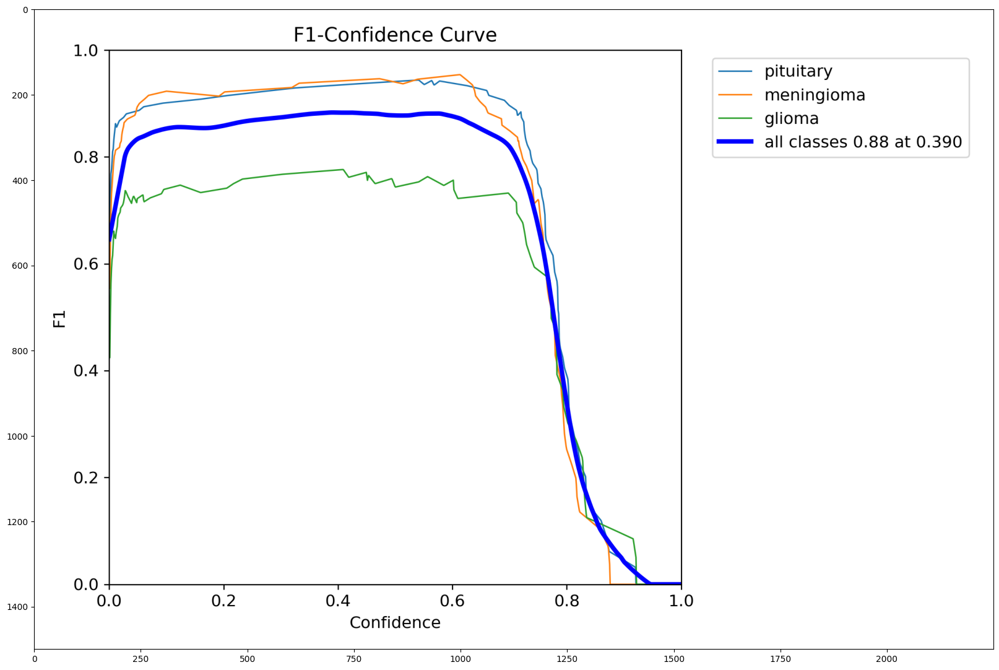

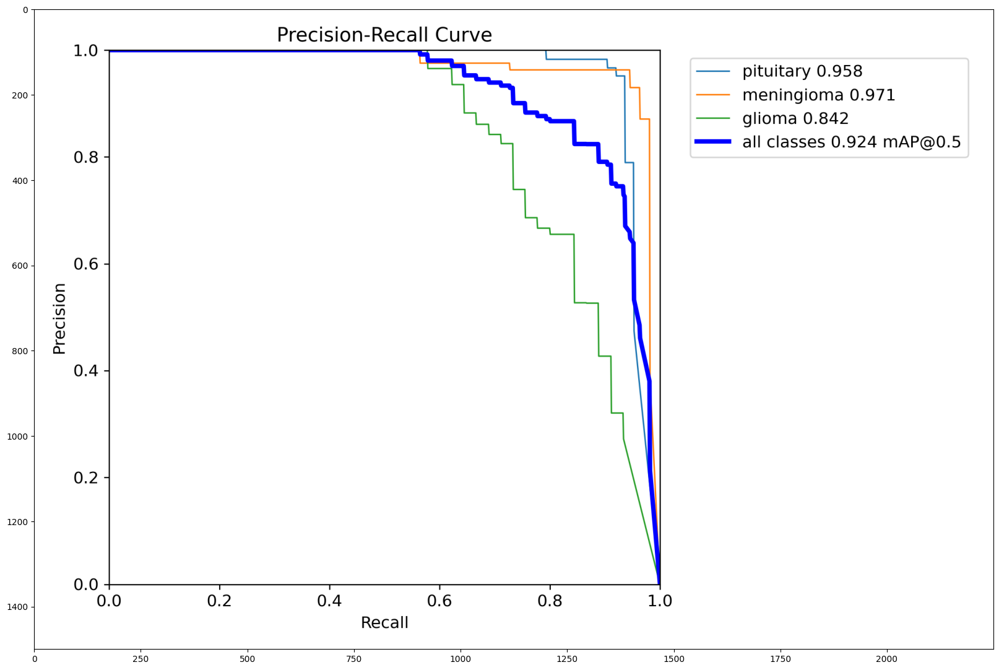

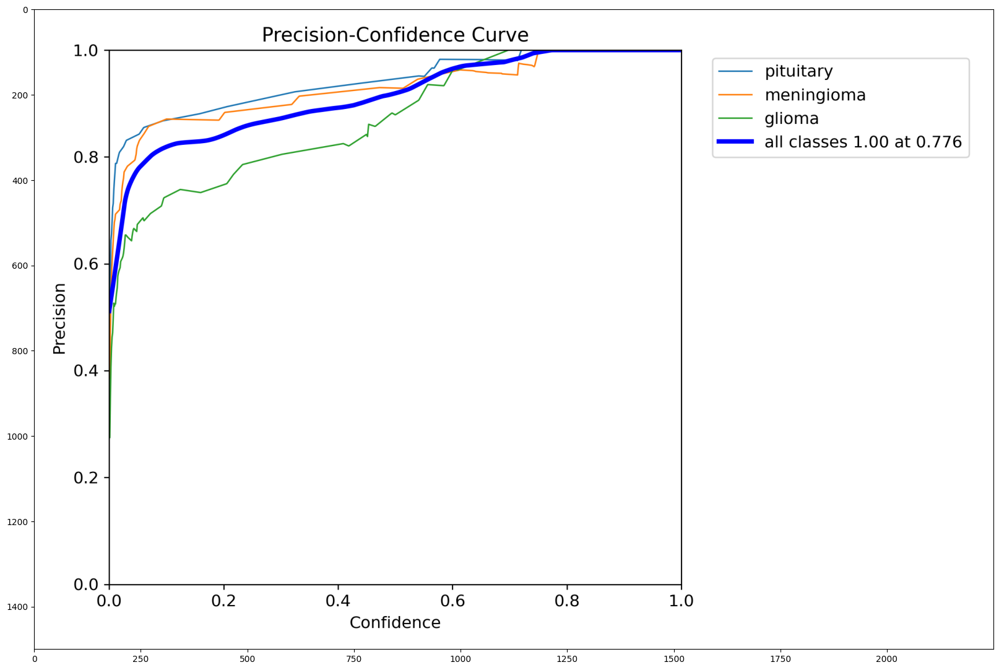

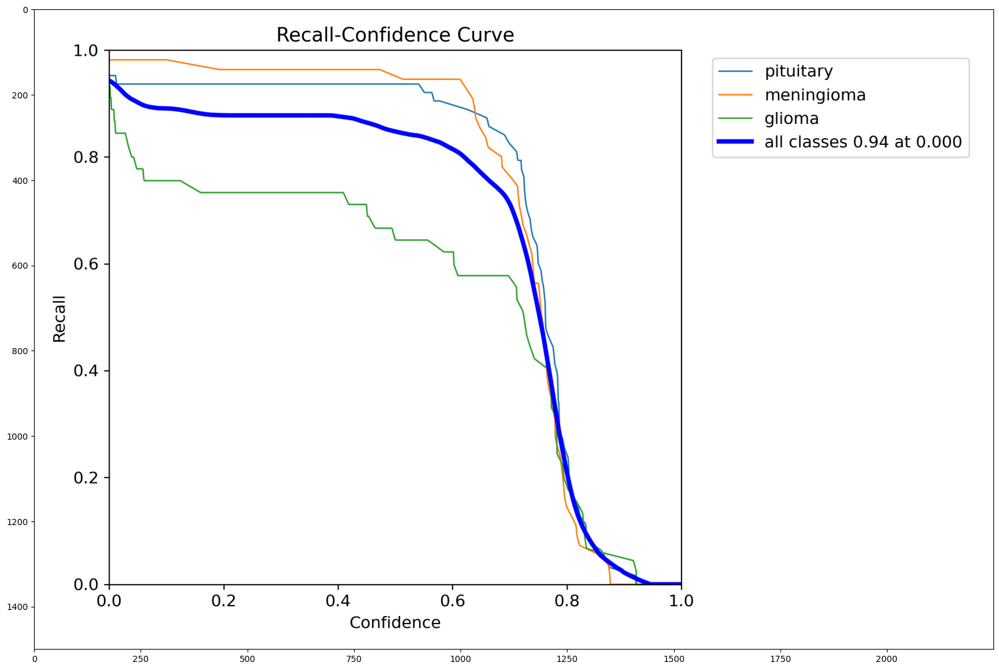

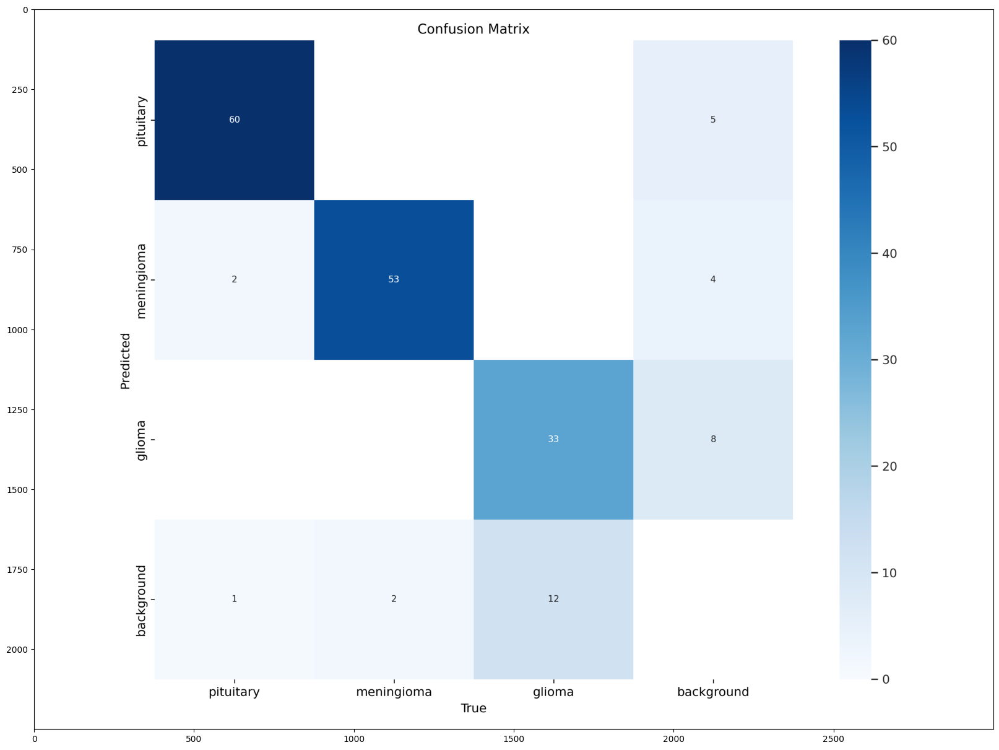

...

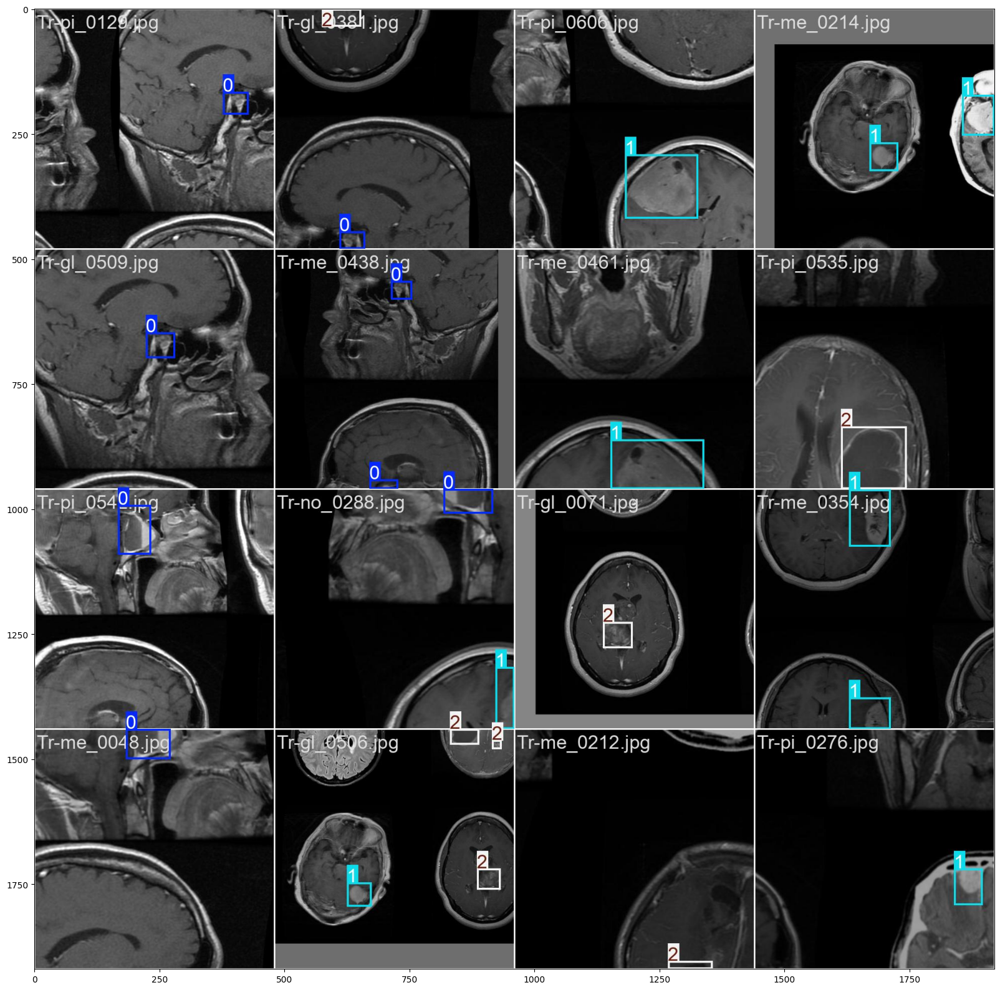

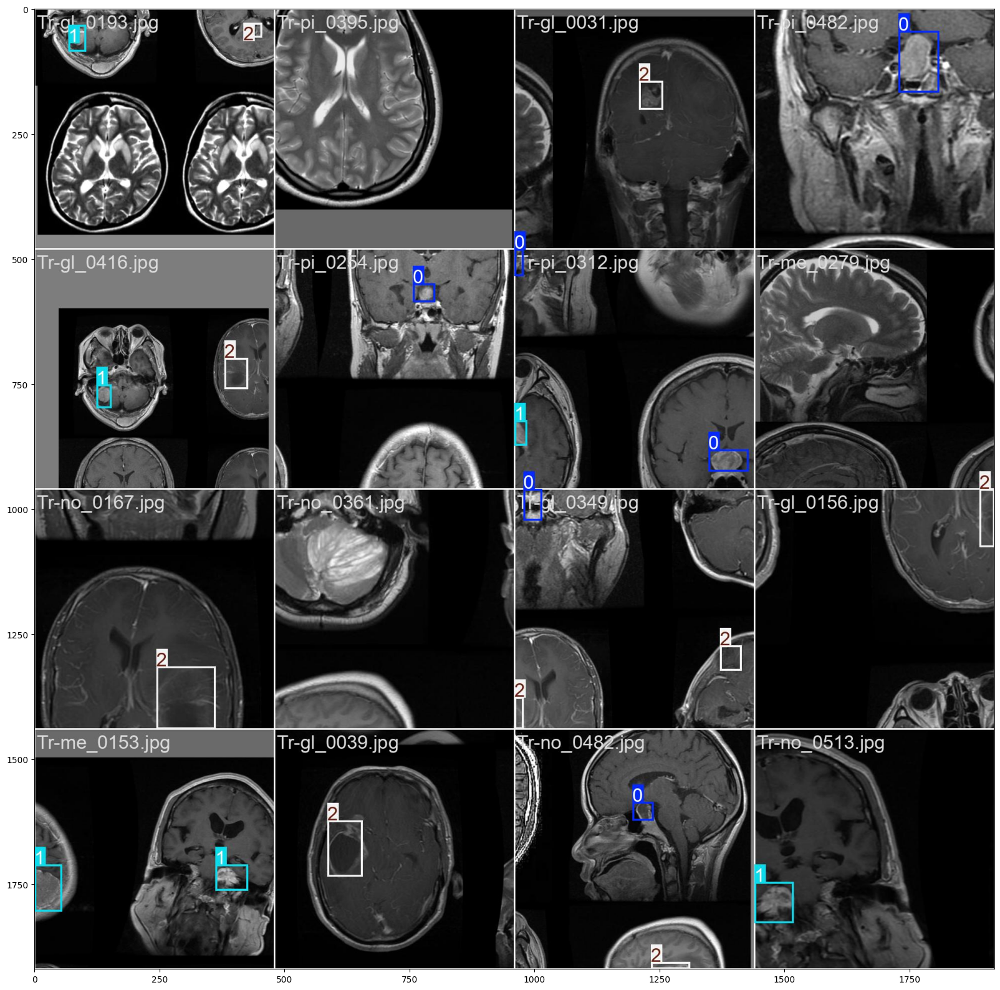

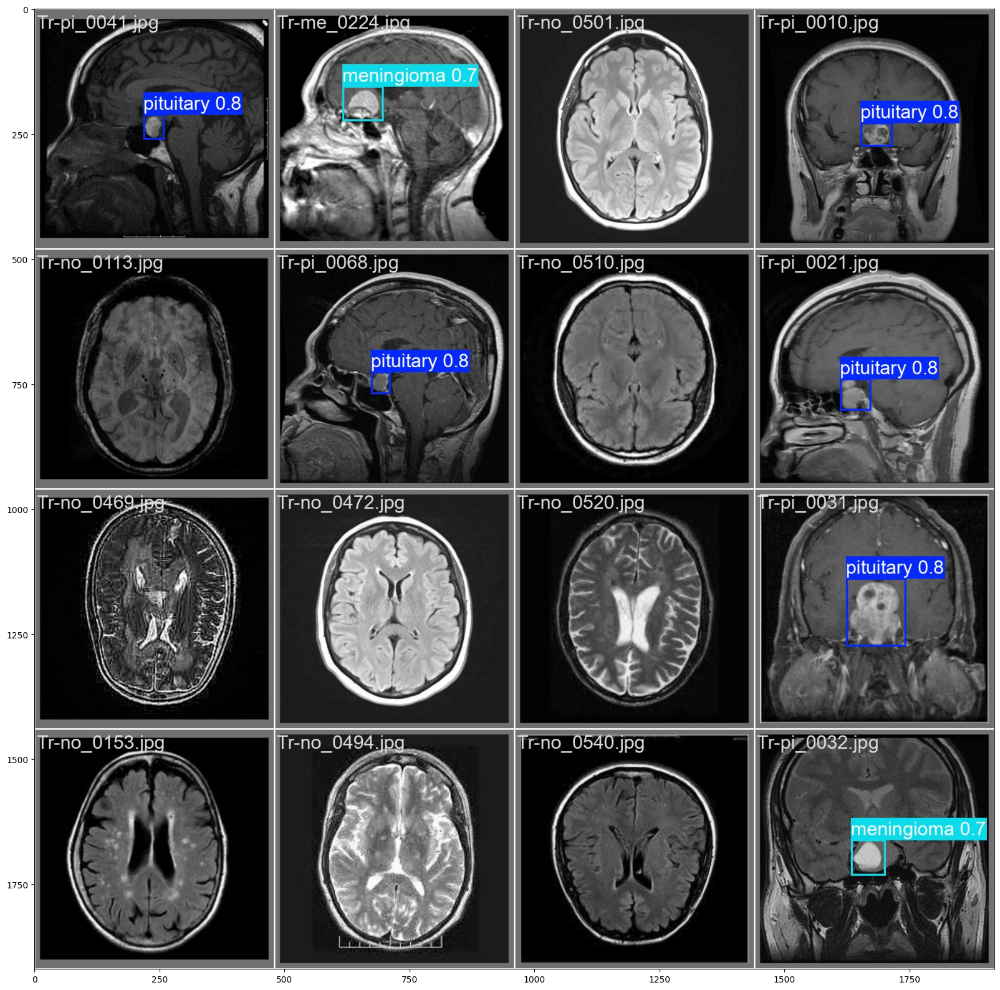

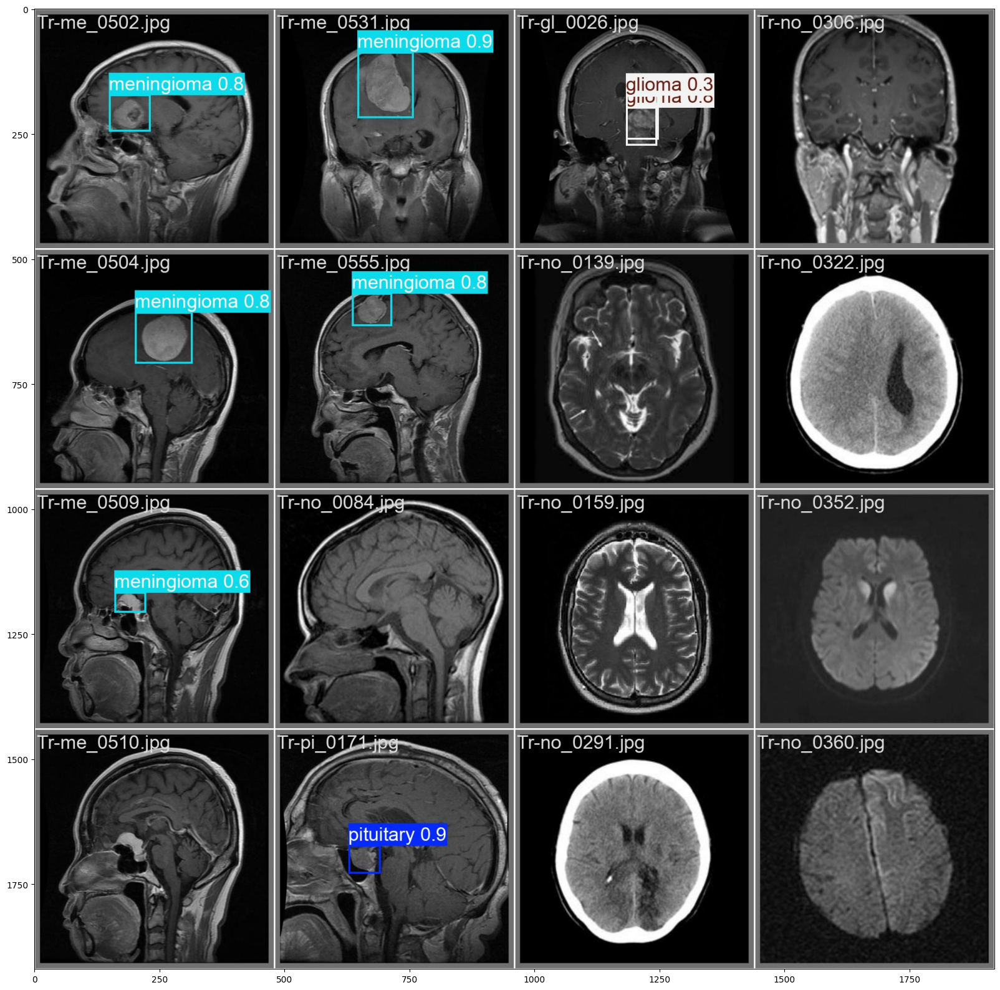

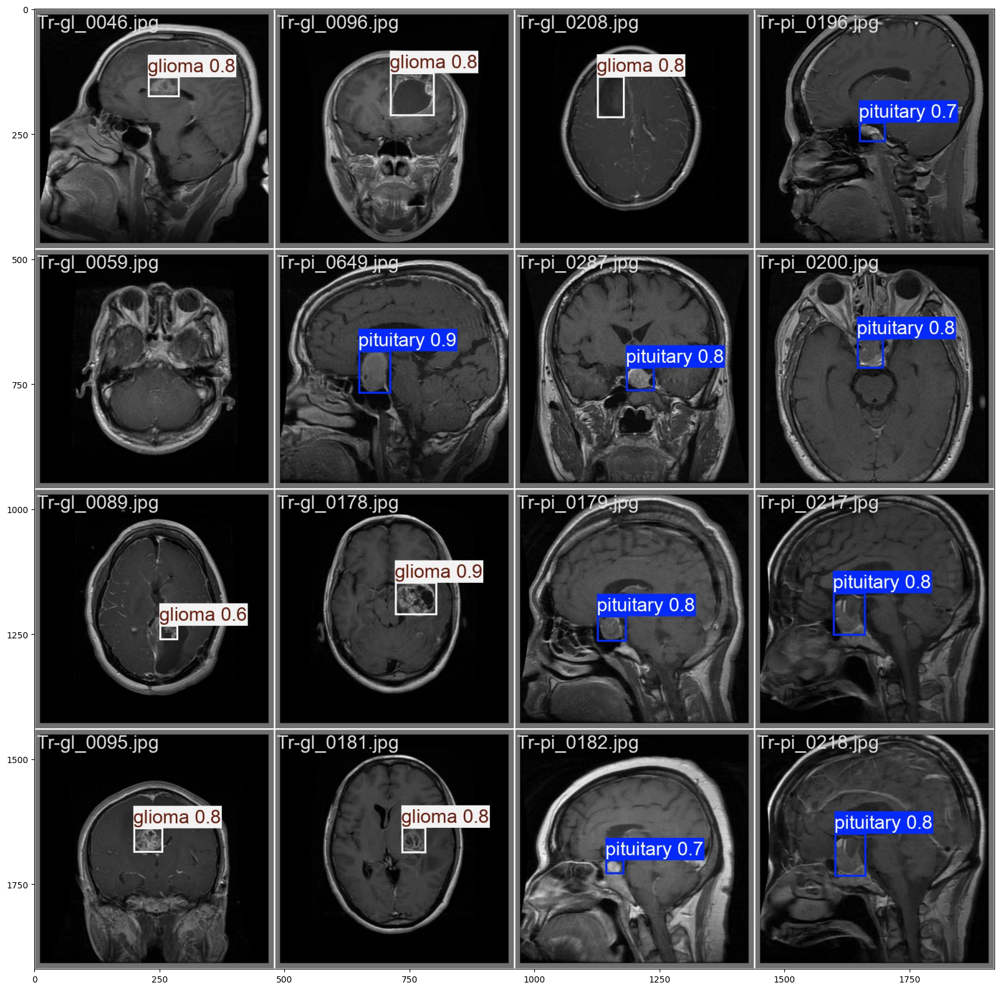

In [7]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

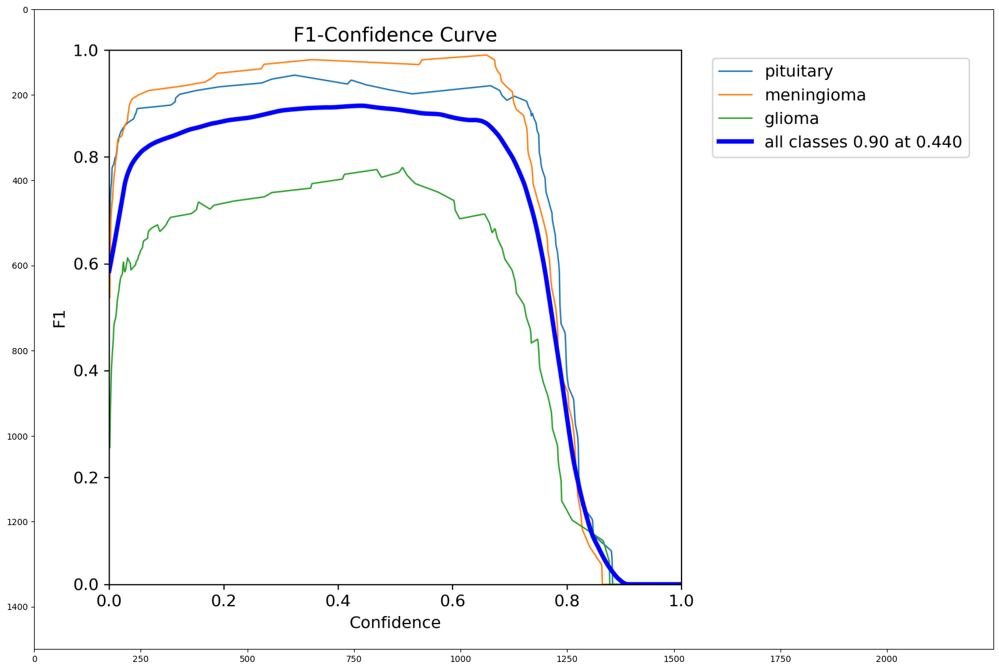

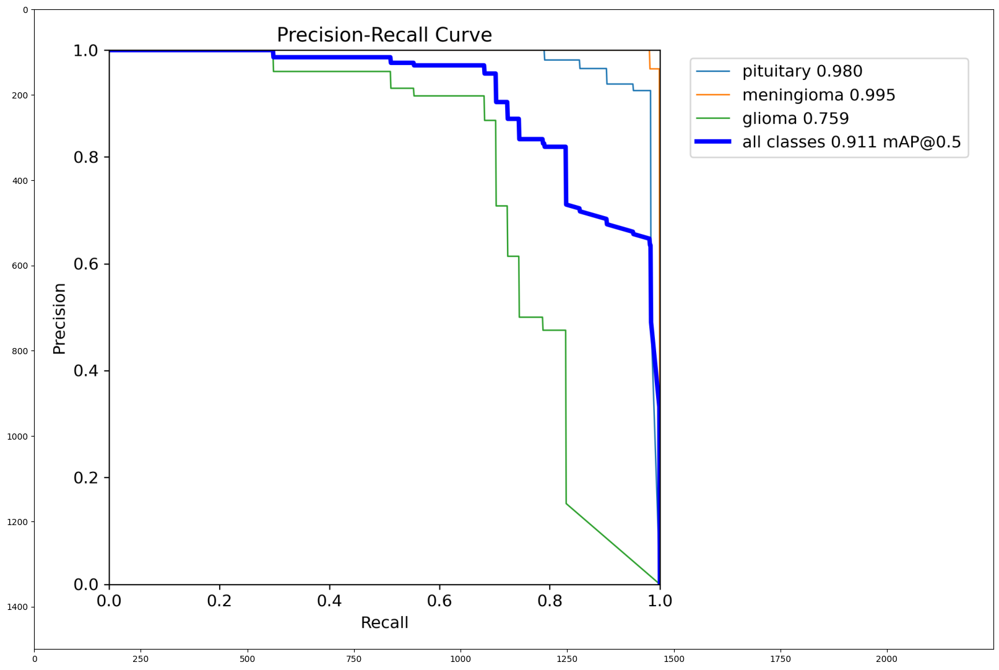

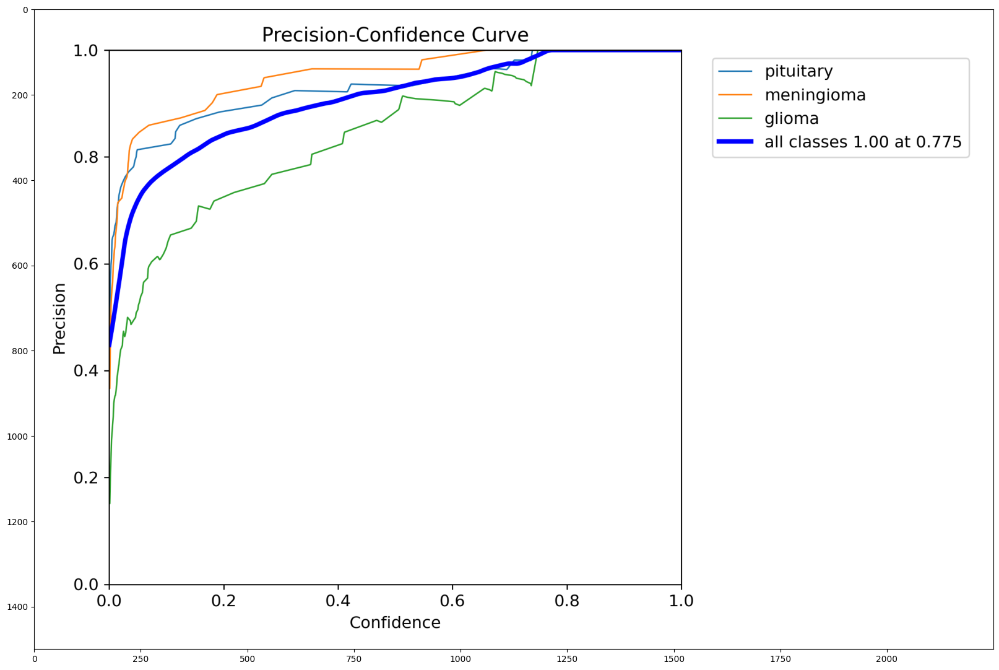

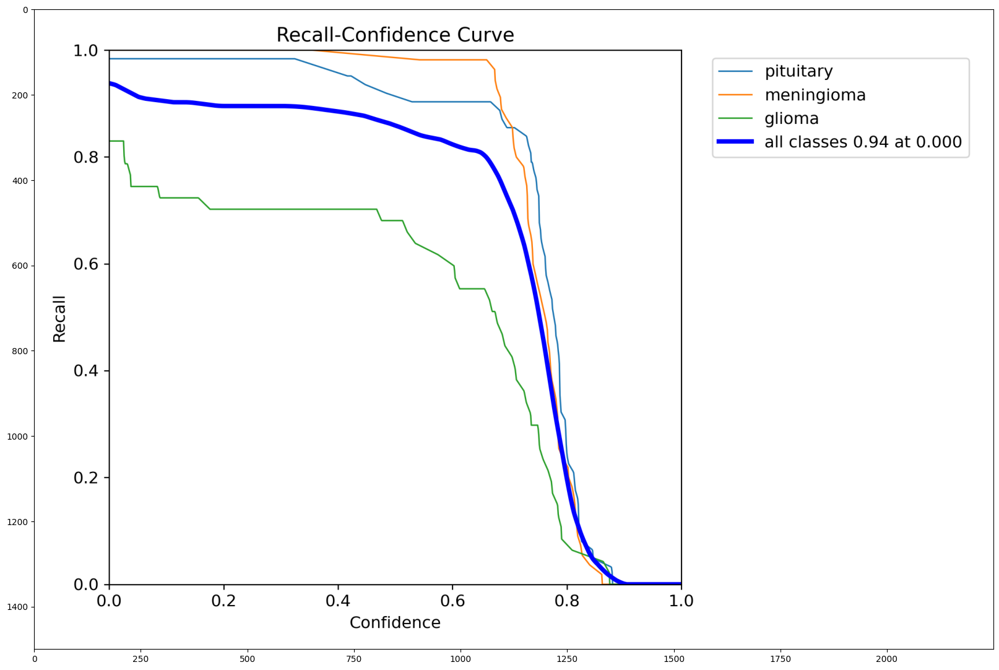

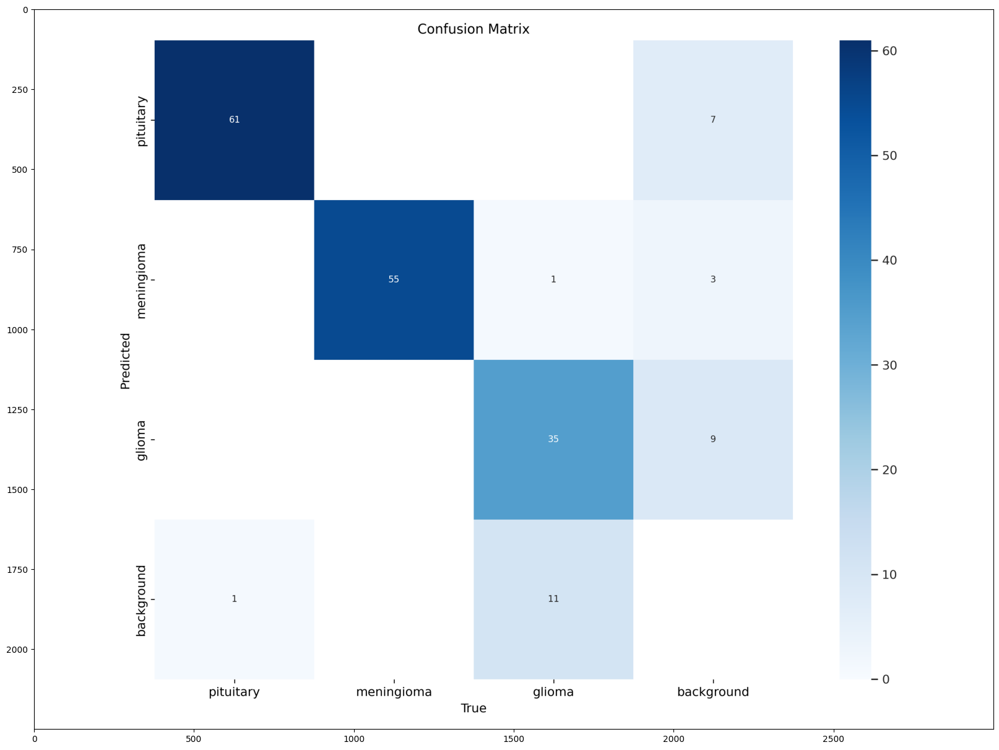

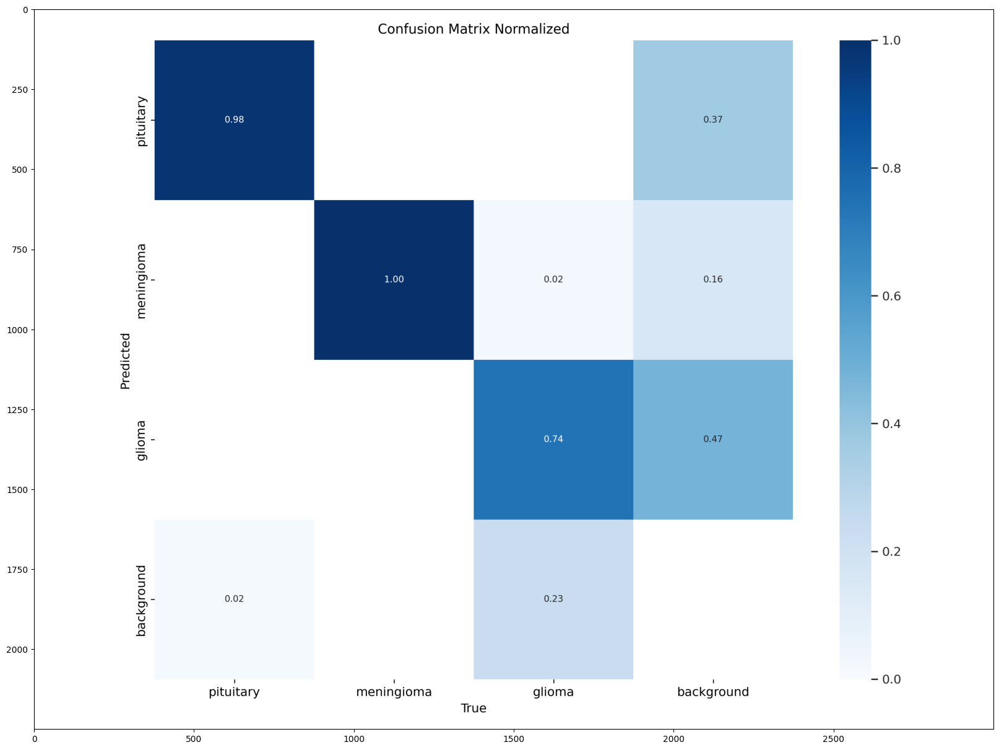

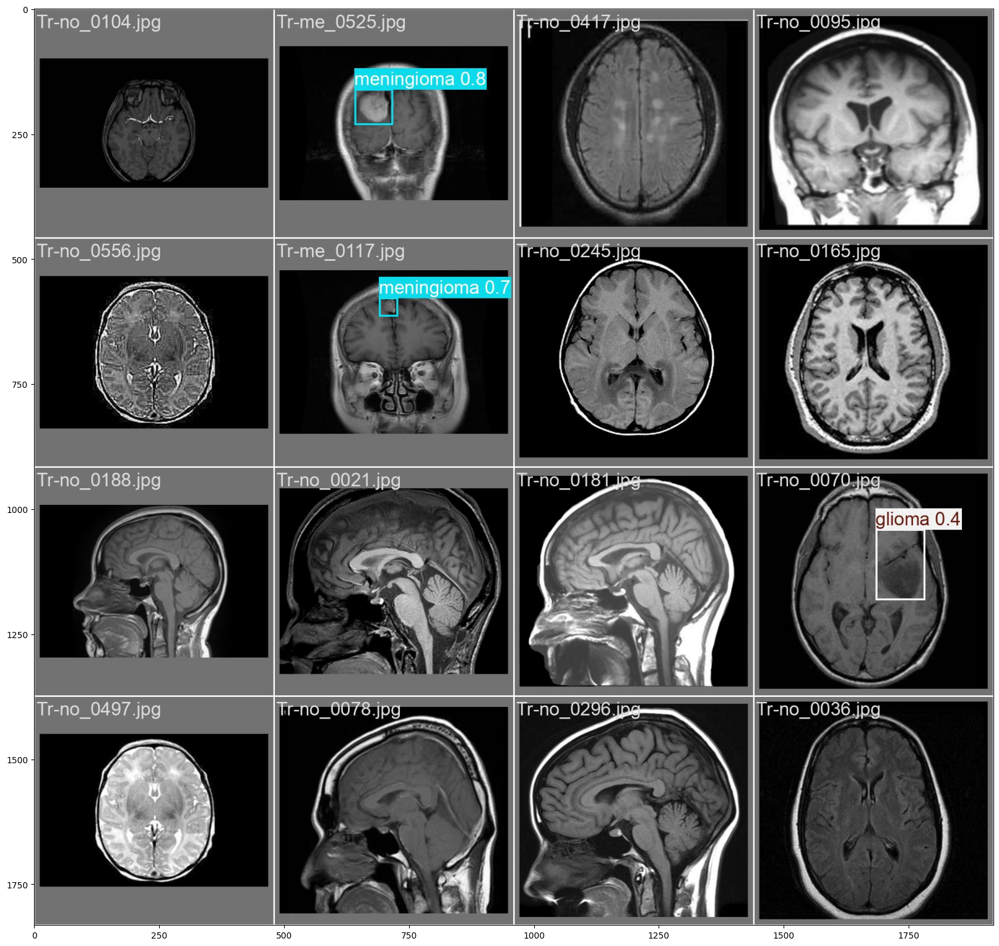

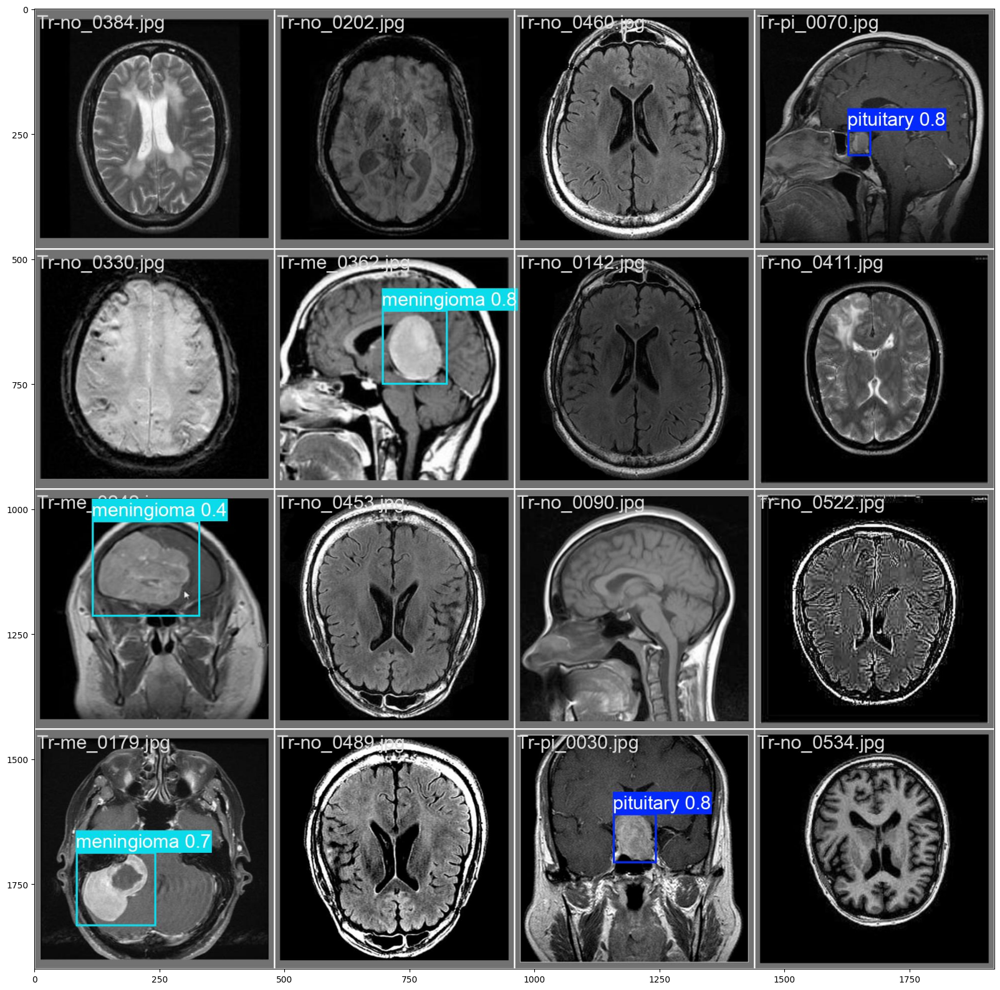

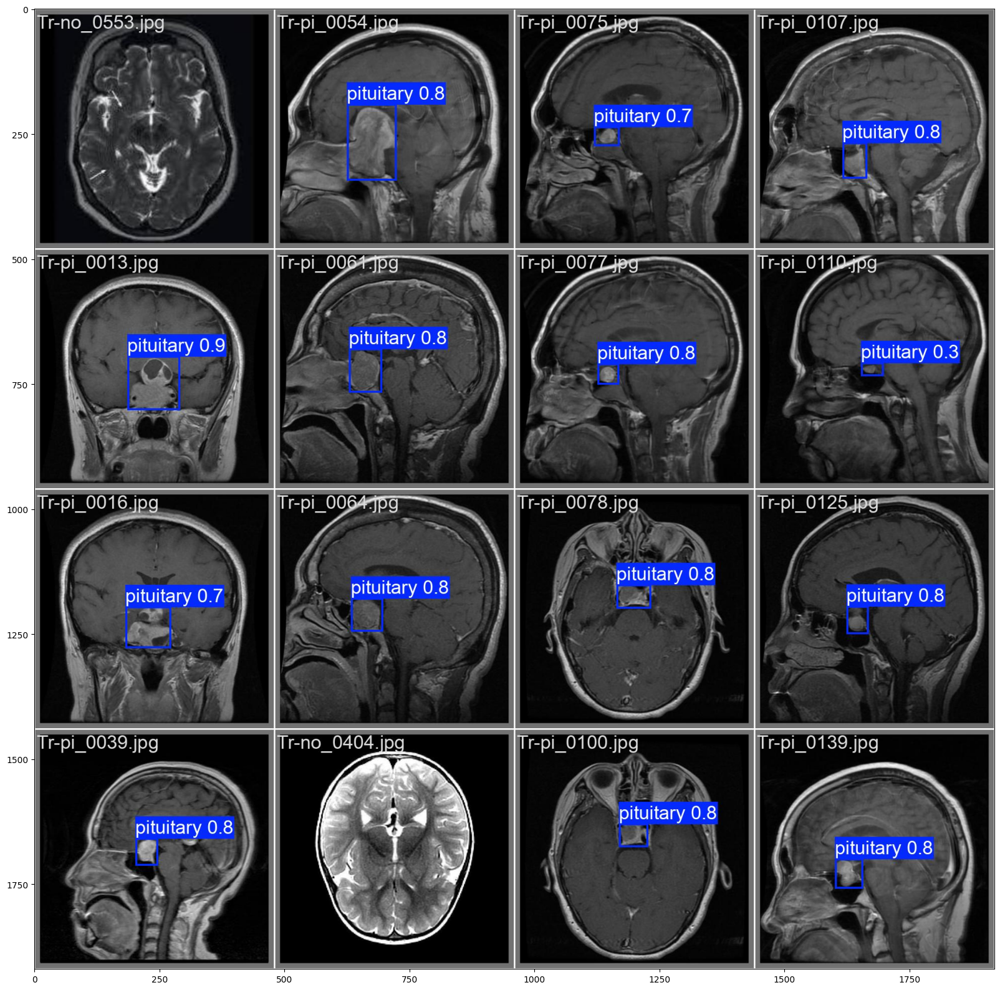

In [8]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()